## Importing Packages

In [1]:
!pip install graphviz

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, ConfusionMatrixDisplay
from sklearn import tree
import graphviz
from ucimlrepo import fetch_ucirepo

## Preparing the datasets
### 0. Fetching the Datasets
Fetch the 'Letter Recognition' dataset from 'ucimlrepo'

In [3]:
letter_recognition = fetch_ucirepo(id=59) 

### 1. Setting Up the Training and Test Datasets
We will split the original dataset into 4 different splitting strategies, with the proportion of traning and test as follows: 40/60, 60/40, 80/20, and 90/10.

First, we split the original dataset into feature and label columns, as the target we are considering now is 'lettr'

In [4]:
lettr_rec_features = letter_recognition.data.features
lettr_rec_target = letter_recognition.data.targets

if lettr_rec_features is None or lettr_rec_target is None:
    print("No features or target found in the dataset.")

Then the feature and label are split into 4 splitting strategies as mentioned above.

In [5]:
training_sizes = {
    "40/60": 0.4,
    "60/40": 0.6,
    "80/20": 0.8,
    "90/10": 0.9,
}

datasets = {}

for name, train_size in training_sizes.items():
    features_train, features_test, target_train, target_test = train_test_split(
        lettr_rec_features, lettr_rec_target, 
        test_size=1-train_size, 
        train_size=train_size, 
        shuffle=True, 
        stratify=lettr_rec_target
    )

    datasets[name] = {
        "features_train": features_train, 
        "features_test": features_test, 
        "target_train": target_train, 
        "target_test": target_test
    }

After splitting the datasets, the visualization of the class distribution is as follows.

#### Original Set

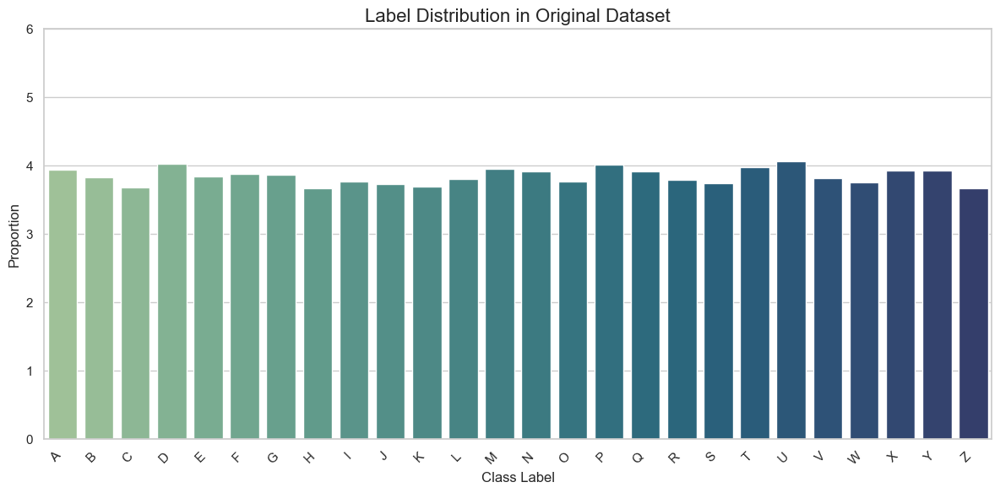

In [6]:
data = lettr_rec_target['lettr']
data_series = pd.Series(data).squeeze()
value_counts = (data_series.value_counts(normalize=True)*100).sort_index()
plt.figure(figsize=(12,6))
sns.set(style="whitegrid")    
sns.barplot(x=value_counts.index, hue=value_counts.index, y = value_counts.values, palette="crest", legend=False)
plt.title("Label Distribution in Original Dataset", fontsize=16)
plt.xlabel("Class Label", fontsize=12)
plt.ylabel("Proportion", fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.ylim(0, 6) #26 classes, so 6% is a good limit
plt.tight_layout()
plt.show()

#### Training Set

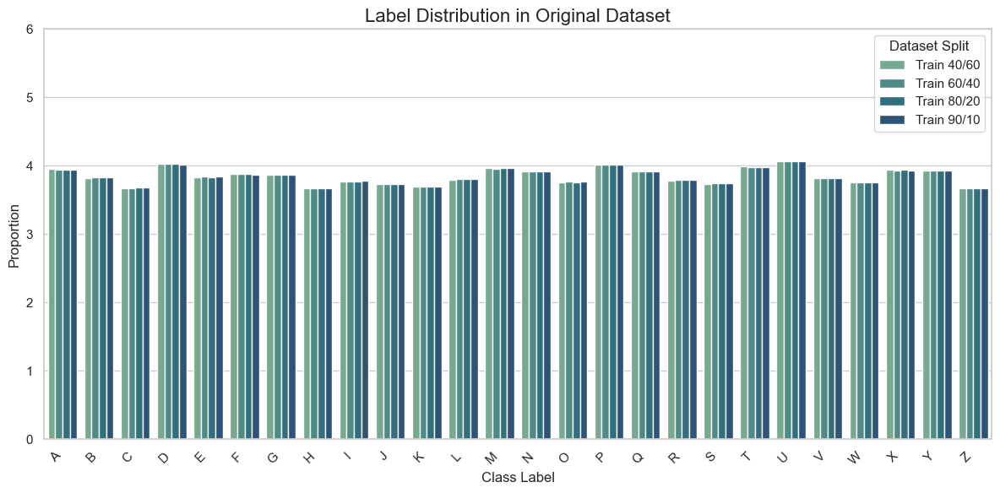

In [7]:
def plot_combined_distribution_bar(datasets, target_key, title):
    combined_data = []
    for name, dataset in datasets.items():
        data = dataset[target_key].squeeze()
        label_counts = (data.value_counts(normalize=True) * 100).sort_index()
        for label, proportion in label_counts.items():
            combined_data.append({
                "Label": label,
                "Proportion": proportion,
                "Split": f"{target_key.replace('target_', '').capitalize()} {name}"
            })

    df_combined = pd.DataFrame(combined_data)
    
    plt.figure(figsize=(12,6))
    sns.set(style="whitegrid")    
    sns.barplot(data=df_combined, x="Label", y="Proportion", hue="Split", palette="crest")
    plt.title("Label Distribution in Original Dataset", fontsize=16)
    plt.xlabel("Class Label", fontsize=12)
    plt.ylabel("Proportion", fontsize=12)
    plt.xticks(rotation=45, ha='right')
    plt.ylim(0, 6) #26 classes, so 6% is a good limit
    plt.legend(title="Dataset Split")
    plt.tight_layout()
    plt.show()

plot_combined_distribution_bar(datasets, "target_train", "Label Distribution in Training Sets")

#### Test Set

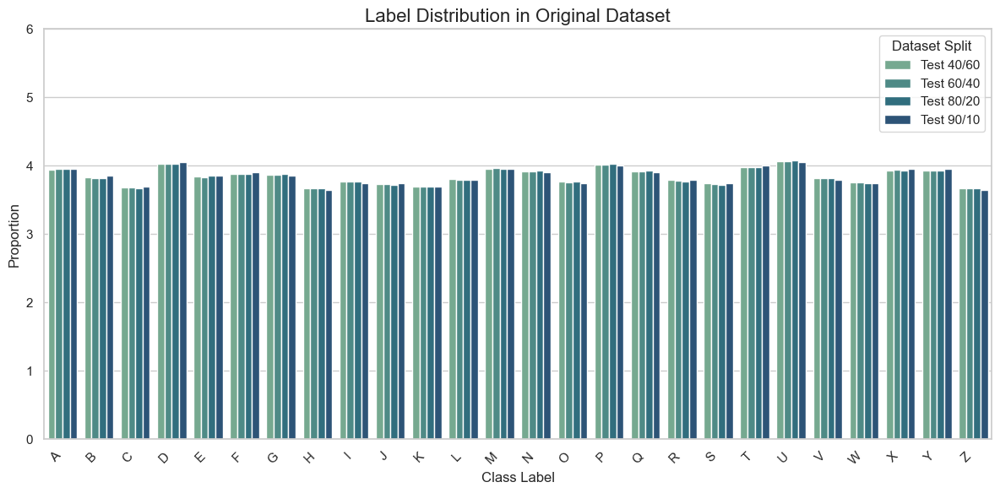

In [8]:
plot_combined_distribution_bar(datasets, "target_test", "Label Distribution in Test Sets")

The visualizations clearly demonstrate that stratified sampling was applied successfully across all training and test splits. Despite slight variations caused by rounding during the splitting process, the class proportions remain consistent and closely aligned with the original dataset. This ensures that each subset maintains a balanced representation of all 26 classes, providing a fair basis for training and evaluating classification models.

### 2. Building the Decision Tree Classifiers

After preparing the datasets, we now fit a Decision Tree Classifier to each training set and visualize the decision tree result.

#### Model Training
We apply the `DecisionTreeClassifier` on each splitted subsets.

In [9]:
models = {}

for name, dataset in datasets.items():
    X_train = dataset["features_train"]
    y_train = dataset["target_train"].squeeze()

    model = tree.DecisionTreeClassifier(criterion="entropy")
    model.fit(X_train, y_train)

    models[name] = model

#### Visualization
The visualization of the resulting decision trees is processed with Graphviz.

In [10]:
graphs = {}

for name, model in models.items():
    dot_data = tree.export_graphviz(
        model, 
        out_file=None,
        filled=True,
        rounded=True,
        class_names=model.classes_,
    )
    graph = graphviz.Source(dot_data)
    graphs[name] = graph


Decision Tree Graph for 40/60 splitting.

In [11]:
graphs['40/60']

Decision Tree Graph for 60/40 splitting.

In [12]:
graphs['60/40']

Decision Tree Graph for 80/20 splitting.

In [13]:
graphs['80/20']

Decision Tree Graph for 90/10 splitting.

In [14]:
graphs['90/10']

### 3. Evaluating the Decison Tree Classifiers

In [15]:
def evaluating_tree_classifiers(model, name):
    X_test = datasets[name]["features_test"]
    y_test = datasets[name]["target_test"].squeeze()
    y_pred = model.predict(X_test)

    print(f"\n=== Evaluation Report for {name} ===")
    
    report_dict = classification_report(
        y_test, y_pred, labels=model.classes_, output_dict=True
    )
    report_df = pd.DataFrame(report_dict).transpose()

    display(report_df.round(2))

    cm = confusion_matrix(y_test, y_pred, labels=model.classes_)
    depth = model.get_depth()
    
    plt.figure(figsize=(10, 8))
    disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=model.classes_)
    disp.plot(cmap='Blues', values_format='d', xticks_rotation='vertical', ax=plt.gca())
    plt.title(f"Confusion Matrix (Depth={depth}, {name} Split)")
    plt.tight_layout()
    plt.grid(False)
    plt.show()


#### a. 40/60 Splitting


=== Evaluation Report for 40/60 ===


,precision,recall,f1-score,support
A,0.90,0.92,0.91,473.00
B,0.79,0.81,0.80,460.00
C,0.86,0.85,0.85,442.00
D,0.78,0.78,0.78,483.00
E,0.81,0.81,0.81,461.00
F,0.79,0.81,0.80,465.00
G,0.78,0.79,0.78,464.00
H,0.69,0.75,0.72,440.00
I,0.90,0.87,0.89,453.00
J,0.85,0.90,0.87,448.00


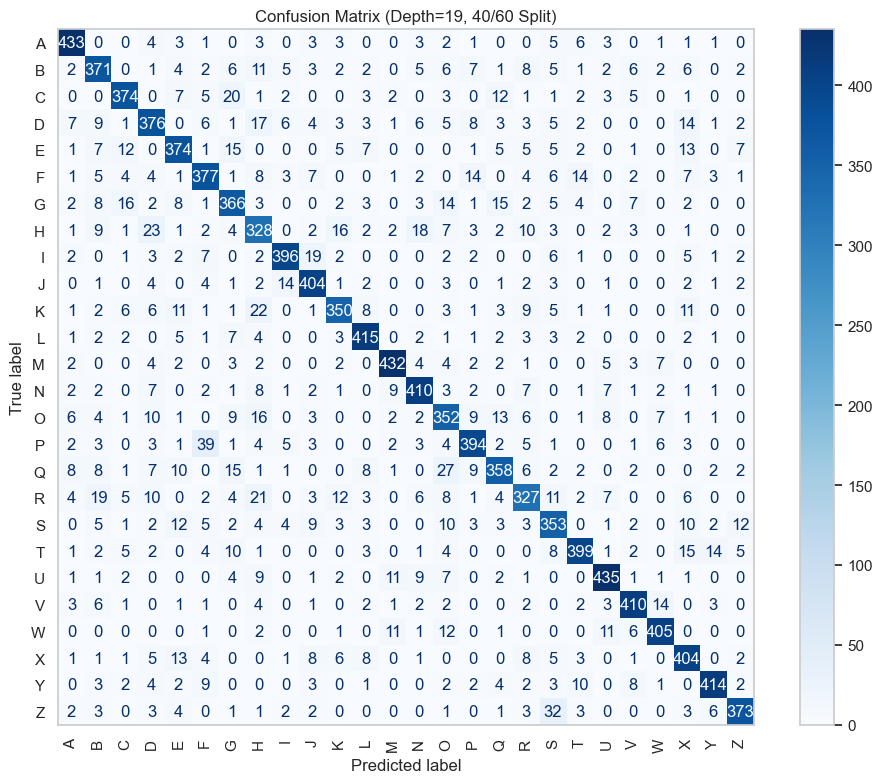

In [16]:

evaluating_tree_classifiers(models['40/60'], '40/60')

#### b. 60/40 Splitting


=== Evaluation Report for 60/40 ===


,precision,recall,f1-score,support
A,0.93,0.95,0.94,316.00
B,0.79,0.81,0.80,306.00
C,0.87,0.82,0.85,295.00
D,0.84,0.83,0.83,322.00
E,0.85,0.82,0.83,307.00
F,0.80,0.78,0.79,310.00
G,0.80,0.84,0.82,309.00
H,0.86,0.83,0.85,294.00
I,0.90,0.91,0.90,302.00
J,0.92,0.84,0.88,299.00


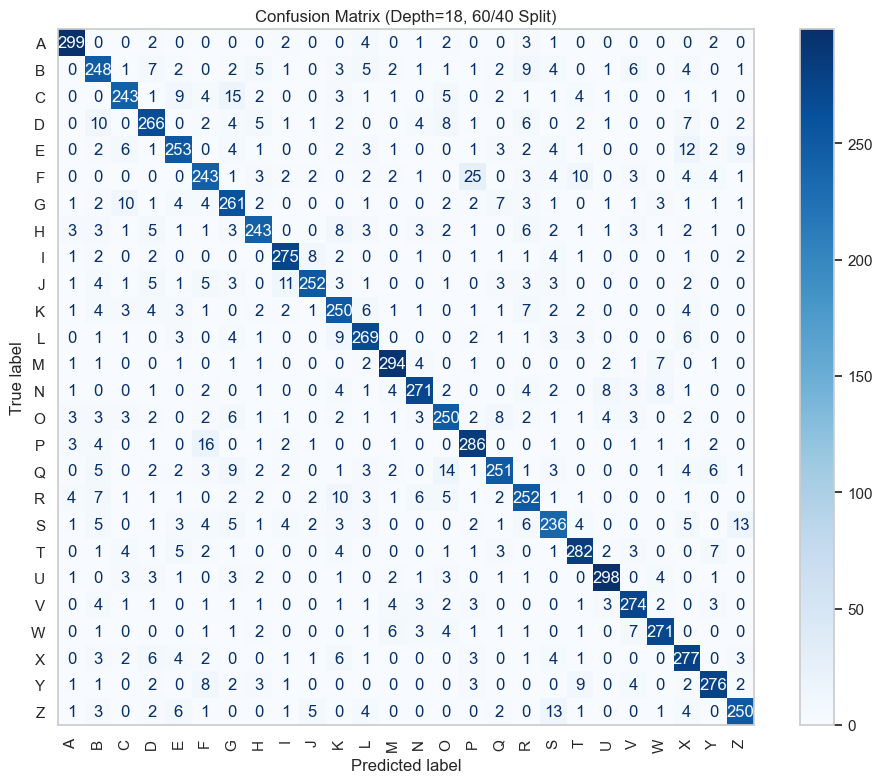

In [17]:
evaluating_tree_classifiers(models['60/40'], '60/40')

#### c. 80/20 Splitting


=== Evaluation Report for 80/20 ===


,precision,recall,f1-score,support
A,0.97,0.94,0.96,158.00
B,0.82,0.82,0.82,153.00
C,0.91,0.91,0.91,147.00
D,0.82,0.84,0.83,161.00
E,0.83,0.86,0.85,154.00
F,0.83,0.85,0.84,155.00
G,0.83,0.89,0.86,155.00
H,0.77,0.84,0.80,147.00
I,0.92,0.86,0.89,151.00
J,0.91,0.87,0.89,149.00


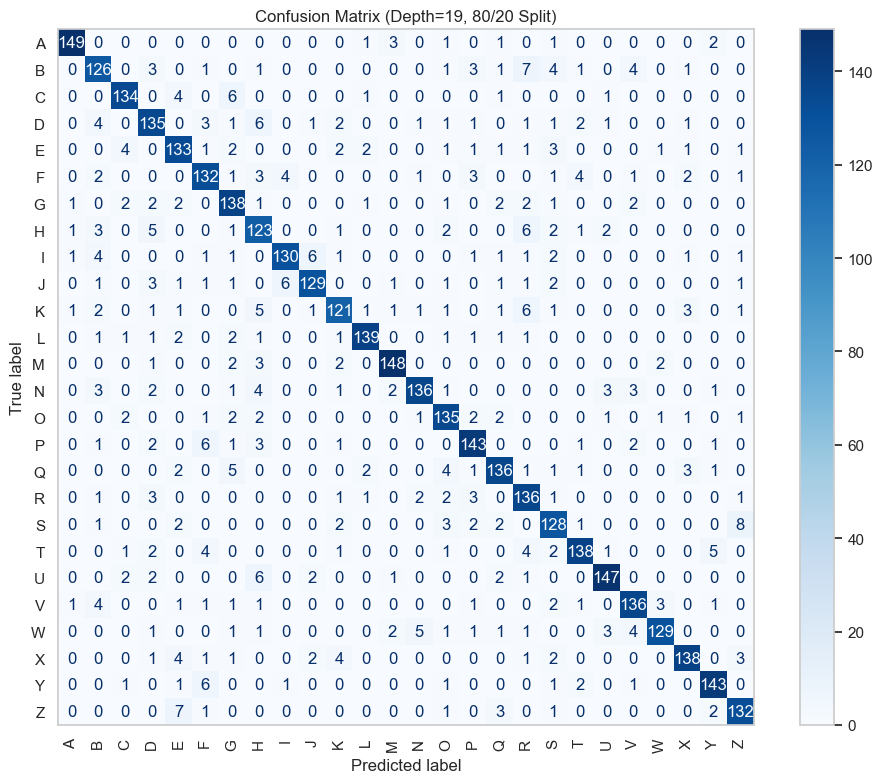

In [18]:
evaluating_tree_classifiers(models['80/20'], '80/20')

#### d. 90/10 Splitting


=== Evaluation Report for 90/10 ===


,precision,recall,f1-score,support
A,0.97,0.90,0.93,79.00
B,0.85,0.87,0.86,77.00
C,0.96,0.89,0.92,74.00
D,0.85,0.78,0.81,81.00
E,0.90,0.91,0.90,77.00
F,0.85,0.91,0.88,78.00
G,0.86,0.87,0.86,77.00
H,0.76,0.81,0.78,73.00
I,0.88,0.92,0.90,75.00
J,0.94,0.87,0.90,75.00


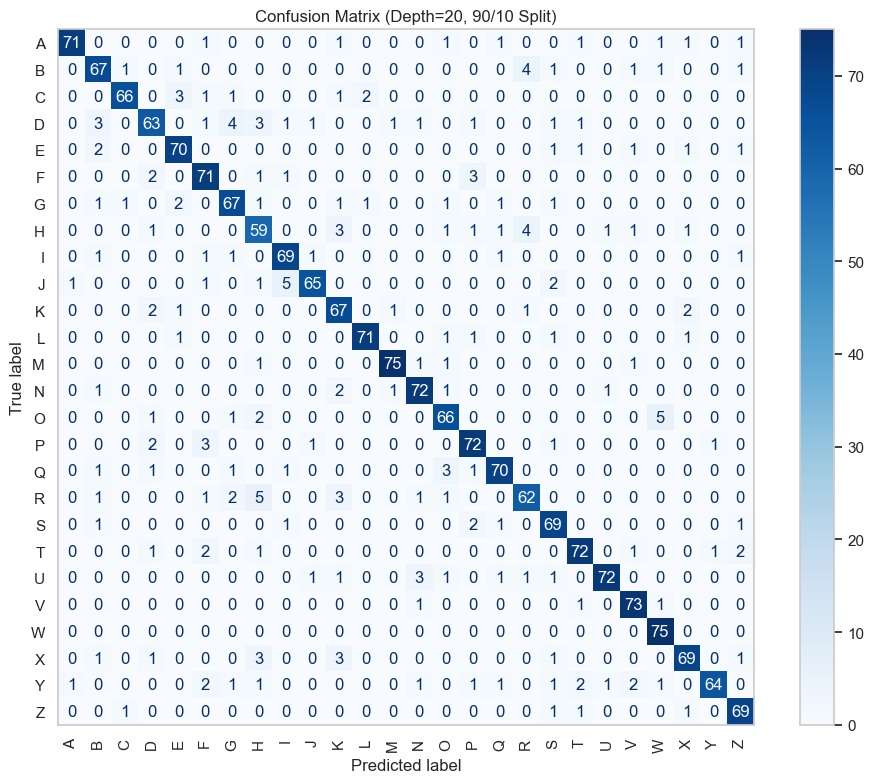

In [19]:
evaluating_tree_classifiers(models['90/10'], '90/10')

#### e. Overall Insights
The confusion matrices across different train/test splits for the Letter Recognition dataset (26 classes from A to Z) demonstrate strong model performance, particularly for deeper trees (e.g., max_depth=18 or 19). The matrices show dense diagonals, indicating that most predictions matched the true labels, especially in the 90/10 and 80/20 splits. Misclassifications are minimal and mostly occur between visually or structurally similar letters, such as C and G, or M and N, which could be due to overlapping feature values (e.g., shape, pixel intensity).
The classification report supports this observation, with a macro-averaged precision, recall, and F1-score consistently around 0.88–0.89, suggesting balanced and reliable predictions across all classes. Even the lowest-performing classes still achieve respectable scores. This highlights that with sufficient depth and data, the decision tree model is capable of handling multi-class classification tasks effectively.

### 4. The Depth and Accuracy of A Decision Tree (80/20 Splitting)

In [20]:
max_depth_values = [None, 2, 3, 4, 5, 6, 7]
X_train = datasets["80/20"]["features_train"]
y_train = datasets["80/20"]["target_train"].squeeze()
X_test = datasets["80/20"]["features_test"]
y_test = datasets["80/20"]["target_test"].squeeze()

models = {}
accuracy_scores = {}
graphs = {}

for max_depth in max_depth_values:
    depth_label = f"Depth={max_depth if max_depth is not None else 'None'}"
    
    model = tree.DecisionTreeClassifier(criterion="entropy", max_depth=max_depth, random_state=42)
    model.fit(X_train, y_train)

    models[depth_label] = model

    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    accuracy_scores[depth_label] = accuracy

    dot_data = tree.export_graphviz(
        model, 
        out_file=None,
        filled=True,
        rounded=True,
        class_names=model.classes_,
    )
    graph = graphviz.Source(dot_data)
    graphs[depth_label] = graph

In [21]:
graphs['Depth=None']

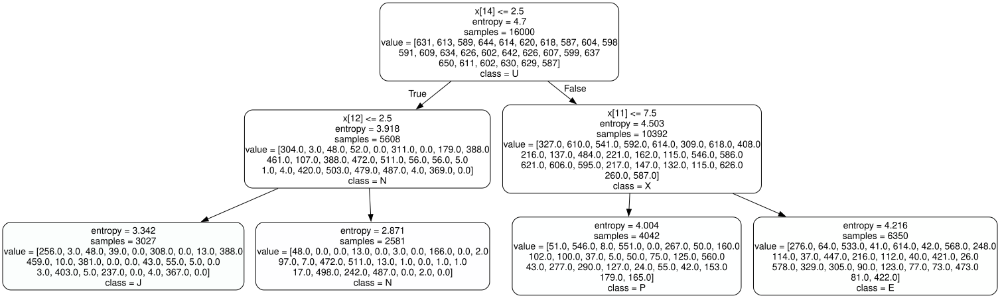

In [22]:
graphs['Depth=2']

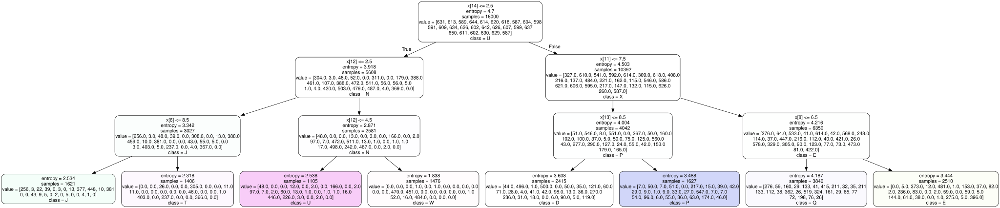

In [23]:
graphs['Depth=3']

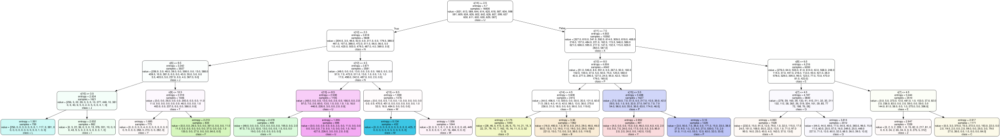

In [24]:
graphs['Depth=4']

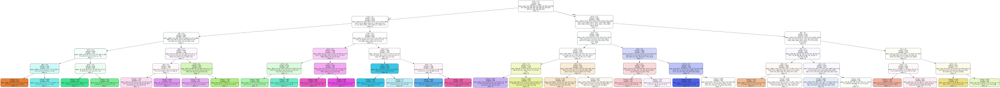

In [25]:
graphs['Depth=5']

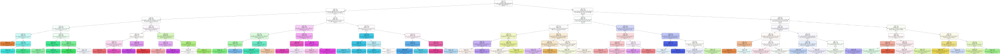

In [26]:
graphs['Depth=6']

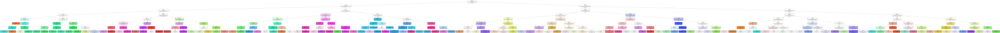

In [27]:
graphs['Depth=7']

In [28]:
flat_scores = {
    k.replace("Depth=", "").replace("None", "None"): v 
    for k, v in accuracy_scores.items()
}

flat_scores = dict(sorted(
    flat_scores.items(),
    key=lambda x: 1 if x[0] == "None" else int(x[0])
))

accuracy_table = pd.DataFrame([flat_scores], index=["Accuracy"]).round(4)

display(accuracy_table)


,None,2,3,4,5,6,7
Accuracy,0.88,0.1312,0.2372,0.3502,0.4975,0.6008,0.6622


#### Insights
The experimental results show a clear relationship between tree depth and model accuracy. With shallow trees (e.g., depth = 2 or 3), the model struggled to learn meaningful patterns, resulting in low accuracies of 13.1% and 23.8%, respectively—indicating significant underfitting. As the depth increased, the accuracy steadily improved, reaching 64.2% at depth = 7. The highest accuracy of 88.7% was achieved when max_depth=None, allowing the tree to grow fully. While this maximizes training fit, it may also lead to overfitting, especially if the model captures noise rather than generalizable patterns. Overall, a depth of 6 or 7 appears to offer a balanced trade-off between performance and complexity for this dataset.